In [ ]:
!pip install easyocr
!pip install imutils
!pip install rembg
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 21.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 37.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 35.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 32.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 6.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 51.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.9/422.9 kB 28.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96

In [ ]:
import os
from google.colab import drive
from PIL import Image
import cv2
import matplotlib.pyplot as plt
from pathlib import Path
import imutils
import numpy as np
from ultralytics import YOLO
import easyocr

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
import pandas as pd

# Mostrar imágenes dentro del notebook
%matplotlib inline

# Montar Google Drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
# Extraemos el modelo reentrenado en el código anterior de la carpeta runs/detect
! unzip "/content/drive/MyDrive/Data_Plates_Detection/detect" -d /content/modelYOLO

Archive:  /content/drive/MyDrive/Data_Plates_Detection/detect.zip
   creating: /content/modelYOLO/detect/
   creating: /content/modelYOLO/detect/train/
  inflating: /content/modelYOLO/detect/train/confusion_matrix.png  
  inflating: /content/modelYOLO/detect/train/results.csv  
  inflating: /content/modelYOLO/detect/train/confusion_matrix_normalized.png  
  inflating: /content/modelYOLO/detect/train/F1_curve.png  
  inflating: /content/modelYOLO/detect/train/PR_curve.png  
  inflating: /content/modelYOLO/detect/train/P_curve.png  
  inflating: /content/modelYOLO/detect/train/R_curve.png  
  inflating: /content/modelYOLO/detect/train/args.yaml  
  inflating: /content/modelYOLO/detect/train/val_batch1_labels.jpg  
  inflating: /content/modelYOLO/detect/train/labels.jpg  
  inflating: /content/modelYOLO/detect/train/events.out.tfevents.1738684854.9cf76e059d9a.2545.0  
  inflating: /content/modelYOLO/detect/train/labels_correlogram.jpg  
  inflating: /content/modelYOLO/detect/train/results

In [ ]:
# Cargar modelo YOLO (ya está preentrenado en Colab)
model = YOLO('/content/modelYOLO/detect/train/weights/best.pt')
csv_path = '/content/drive/MyDrive/Data_Plates_Detection/plates_combinado.csv'

# Usamos un dataframe para testear las placas reconocidas por el modelo
columns = ['imagen', 'placa1', 'placa2', 'placa3']
df_placas = pd.read_csv(csv_path, names=columns)

In [ ]:
df_placas.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   imagen  100 non-null    object
 1   placa1  100 non-null    object
 2   placa2  23 non-null     object
 3   placa3  4 non-null      object
dtypes: object(4)
memory usage: 3.3+ KB


In [ ]:
! unzip "/content/drive/MyDrive/Data_Plates_Detection/placas_redimensionadas" -d /content/datasets

Archive:  /content/drive/MyDrive/Data_Plates_Detection/placas_redimensionadas.zip
   creating: /content/datasets/placas_redimensionadas/
  inflating: /content/datasets/placas_redimensionadas/fotoPlaca82.jpg  
  inflating: /content/datasets/placas_redimensionadas/fotoPlaca43.jpg  
  inflating: /content/datasets/placas_redimensionadas/fotoPlaca93.jpg  
  inflating: /content/datasets/placas_redimensionadas/fotoPlaca34.jpg  
  inflating: /content/datasets/placas_redimensionadas/foto26.jpg  
  inflating: /content/datasets/placas_redimensionadas/foto19.jpg  
  inflating: /content/datasets/placas_redimensionadas/fotoPlaca96.jpg  
  inflating: /content/datasets/placas_redimensionadas/fotoPlaca61.jpg  
  inflating: /content/datasets/placas_redimensionadas/fotoPlaca54.jpg  
  inflating: /content/datasets/placas_redimensionadas/foto14.jpg  
  inflating: /content/datasets/placas_redimensionadas/fotoPlaca80.jpg  
  inflating: /content/datasets/placas_redimensionadas/foto18.jpg  
  inflating: /conte

In [ ]:
def normalize_text(text):
    """Elimina espacios, convierte el texto a mayúsculas."""
    # Elimina espacios y convierte a mayúsculas
    text = text.replace(" ", "").upper()
    return text

def enhance_image(img):
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8,8))
    cl = clahe.apply(l)
    enhanced = cv2.merge((cl, a, b))
    return cv2.cvtColor(enhanced, cv2.COLOR_LAB2BGR)

def detect_license_plates(img_path, real_plates):
    img = cv2.imread(img_path)
    img_enhanced = enhance_image(img)
    gray = cv2.cvtColor(img_enhanced, cv2.COLOR_BGR2GRAY)

    # Realizar predicciones con YOLO
    preds = model(img_path)
    reader = easyocr.Reader(['es'])
    detected_plates = []

    if preds:
        pred = preds[0]
        for *xyxy, conf, cls in pred.boxes.data:
            x1, y1, x2, y2 = map(int, xyxy)
            plate_img = gray[y1:y2, x1:x2]
            result = reader.readtext(plate_img)

            if result:
                plate_text = normalize_text(result[0][-2])  # Normalizar texto detectado
                detected_plates.append(plate_text)

                # Dibujar resultado
                plt.figure(figsize=(10,5))
                plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
                rect = plt.Rectangle((x1, y1), x2-x1, y2-y1, fill=False, edgecolor='red', linewidth=2)
                plt.gca().add_patch(rect)
                plt.text(x1, y1-10, plate_text, color='red', fontsize=12,
                         bbox=dict(facecolor='white', alpha=0.5))
                plt.title('Detected License Plate')
                plt.axis('off')
                plt.show()

    # Evaluar si alguna de las placas detectadas coincide con las reales
    for detected in detected_plates:
        if detected in real_plates:
            return True  # Se detectó correctamente al menos una placa
    return False  # No hubo coincidencias

Processing image: fotoPlaca90.jpg
Real plates: ['QHC3333', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca90.jpg: 640x640 1 plate, 11.3ms
Speed: 3.4ms preprocess, 11.3ms inference, 342.6ms postprocess per image at shape (1, 3, 640, 640)


Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete

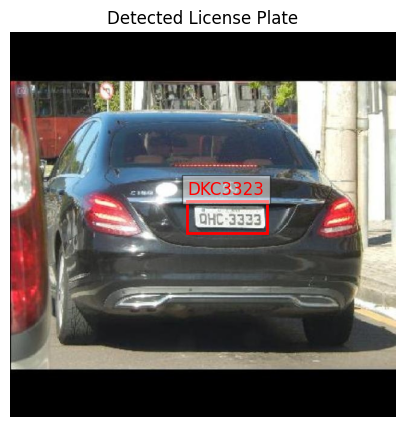

Processing image: fotoPlaca65.jpg
Real plates: ['CAI4935', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca65.jpg: 640x640 1 plate, 16.2ms
Speed: 2.9ms preprocess, 16.2ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)
Processing image: fotoPlaca77.jpg
Real plates: ['AEV3887', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca77.jpg: 640x640 1 plate, 11.8ms
Speed: 2.6ms preprocess, 11.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


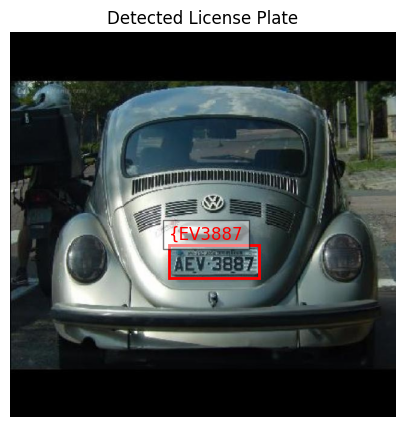

Processing image: fotoPlaca58.jpg
Real plates: ['GEQ8C53', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca58.jpg: 640x640 1 plate, 13.0ms
Speed: 2.5ms preprocess, 13.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


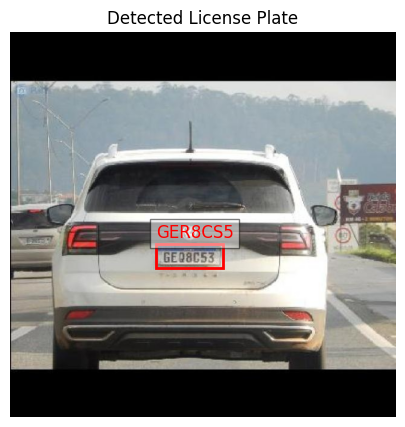

Processing image: fotoPlaca43.jpg
Real plates: ['BDU4H49', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca43.jpg: 640x640 1 plate, 14.4ms
Speed: 3.0ms preprocess, 14.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


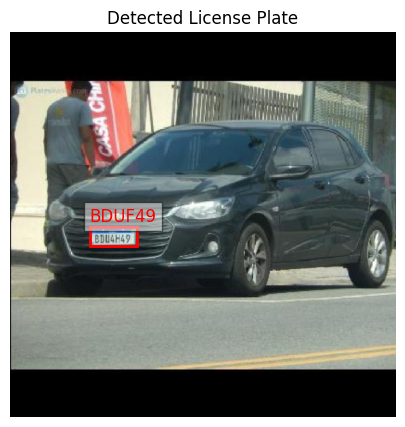

Processing image: fotoPlaca49.jpg
Real plates: ['KZP3586', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca49.jpg: 640x640 1 plate, 13.6ms
Speed: 2.7ms preprocess, 13.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


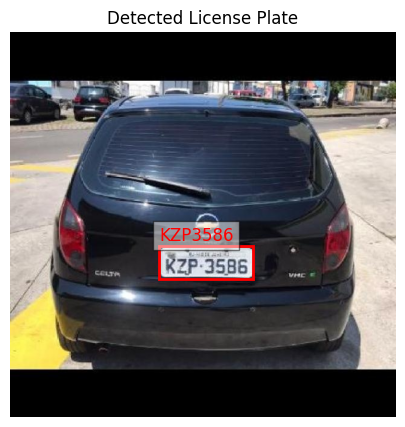

Processing image: fotoPlaca59.jpg
Real plates: ['Q154684', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca59.jpg: 640x640 1 plate, 13.4ms
Speed: 2.8ms preprocess, 13.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


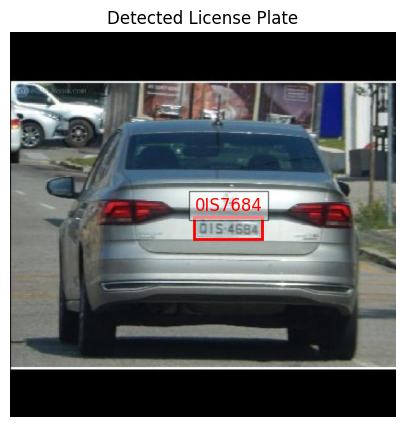

Processing image: foto13.jpg
Real plates: ['NFG502', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto13.jpg: 480x640 1 plate, 62.9ms
Speed: 3.0ms preprocess, 62.9ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


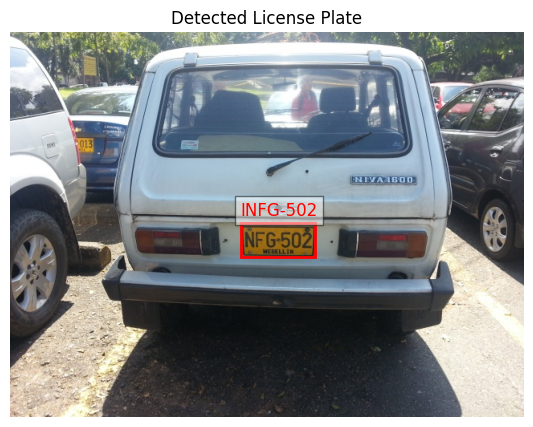

Processing image: fotoPlaca92.jpg
Real plates: ['CQG5923', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca92.jpg: 640x640 1 plate, 13.0ms
Speed: 2.7ms preprocess, 13.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


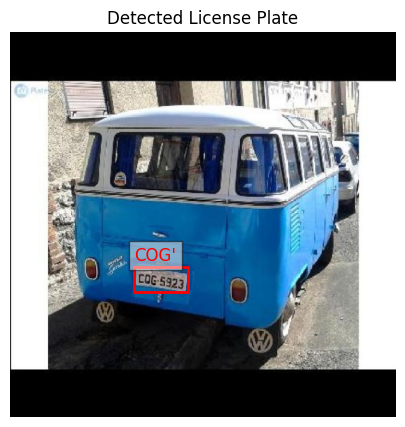

Processing image: fotoPlaca73.jpg
Real plates: ['BBM0841', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca73.jpg: 640x640 1 plate, 12.2ms
Speed: 2.7ms preprocess, 12.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


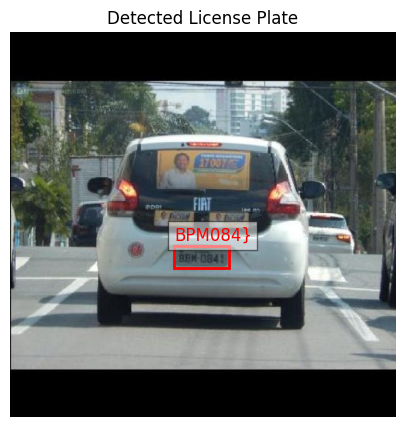

Processing image: fotoPlaca67.jpg
Real plates: ['BCC2152', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca67.jpg: 640x640 1 plate, 19.7ms
Speed: 9.2ms preprocess, 19.7ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


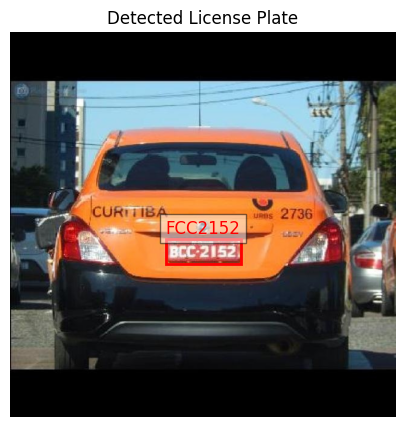

Processing image: fotoPlaca89.jpg
Real plates: ['FFH4717', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca89.jpg: 640x640 2 plates, 15.9ms
Speed: 2.7ms preprocess, 15.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
Processing image: fotoPlaca55.jpg
Real plates: ['FMF2545', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca55.jpg: 640x640 1 plate, 12.2ms
Speed: 2.7ms preprocess, 12.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


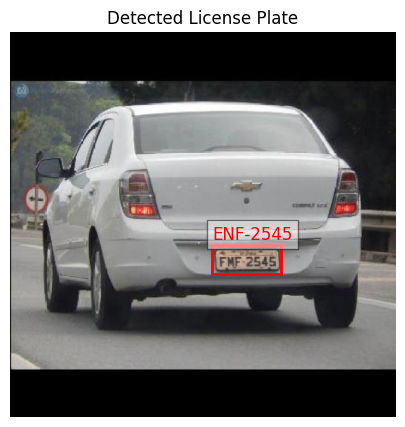

Processing image: fotoPlaca87.jpg
Real plates: ['MLY0C20', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca87.jpg: 640x640 1 plate, 12.4ms
Speed: 2.9ms preprocess, 12.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


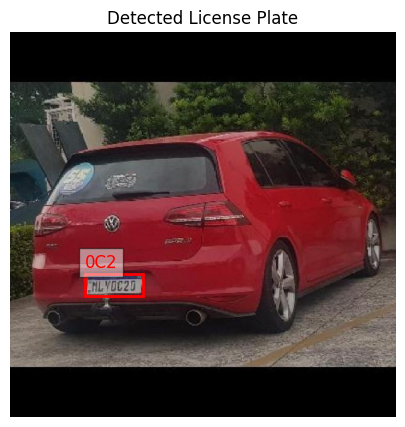

Processing image: foto15.jpg
Real plates: ['ML3614', 'IUA623', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto15.jpg: 640x480 2 plates, 119.9ms
Speed: 2.1ms preprocess, 119.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 480)


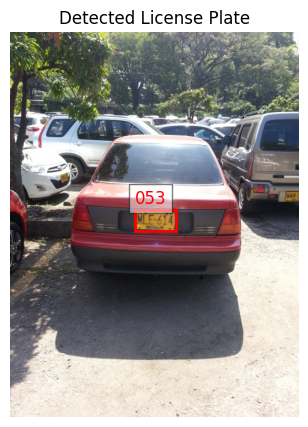

Processing image: fotoPlaca45.jpg
Real plates: ['AAO1168', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca45.jpg: 640x640 (no detections), 12.4ms
Speed: 2.7ms preprocess, 12.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Processing image: fotoPlaca85.jpg
Real plates: ['CVW1E90', 'EXR5121', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca85.jpg: 640x640 2 plates, 12.2ms
Speed: 2.7ms preprocess, 12.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


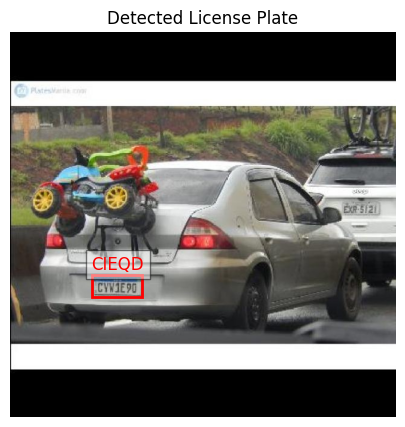

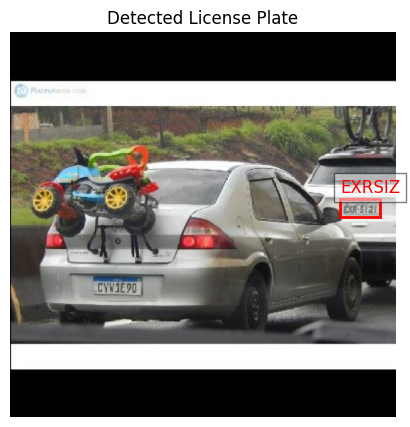

Processing image: foto21.jpg
Real plates: ['DJN766', 'KAO344', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto21.jpg: 480x640 3 plates, 20.0ms
Speed: 2.2ms preprocess, 20.0ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


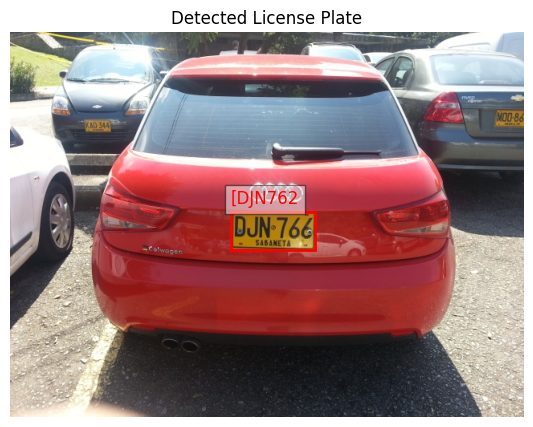

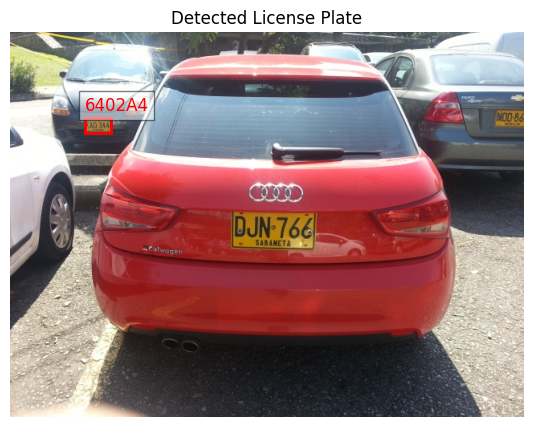

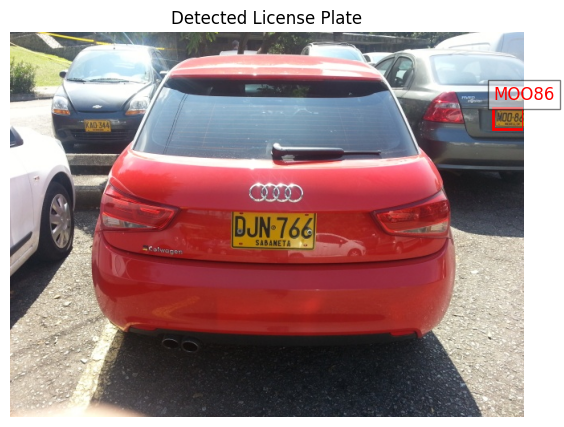

Processing image: fotoPlaca47.jpg
Real plates: ['NLM8374', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca47.jpg: 640x640 1 plate, 13.2ms
Speed: 2.8ms preprocess, 13.2ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


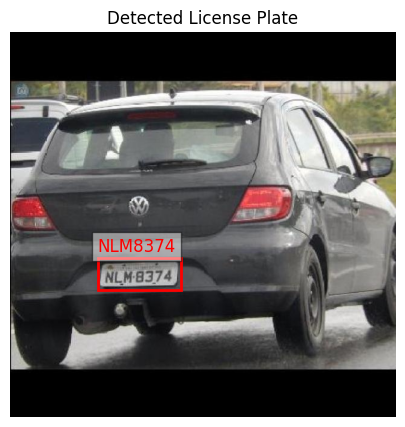

Processing image: fotoPlaca37.jpg
Real plates: ['FJS0D45', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca37.jpg: 640x640 1 plate, 12.8ms
Speed: 2.7ms preprocess, 12.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


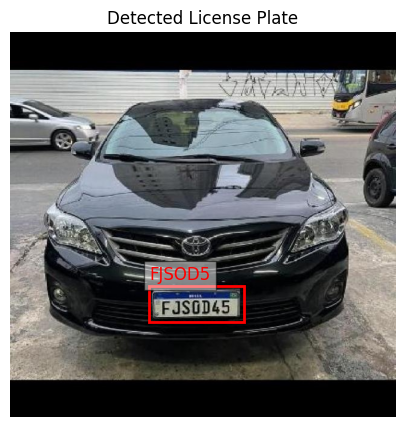

Processing image: foto20.jpg
Real plates: ['IAO855', 'FGO357', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto20.jpg: 480x640 1 plate, 12.7ms
Speed: 2.2ms preprocess, 12.7ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


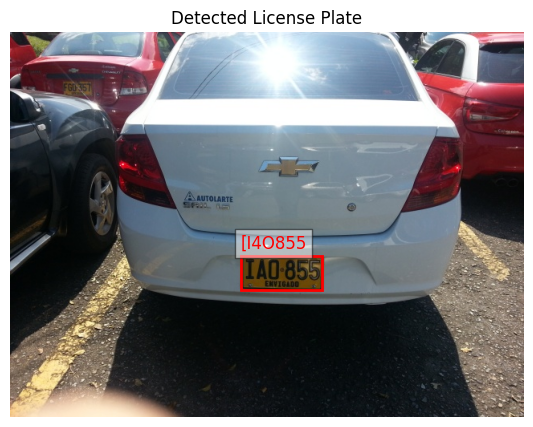

Processing image: fotoPlaca32.jpg
Real plates: ['AZN0C66', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca32.jpg: 640x640 1 plate, 11.6ms
Speed: 2.8ms preprocess, 11.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


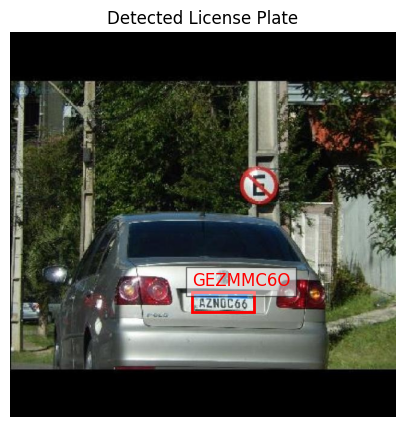

Processing image: fotoPlaca40.jpg
Real plates: ['ONK6907', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca40.jpg: 640x640 1 plate, 13.0ms
Speed: 4.0ms preprocess, 13.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


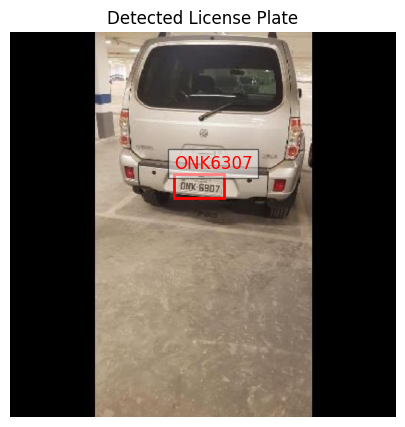

Processing image: foto19.jpg
Real plates: ['KHN106', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto19.jpg: 640x480 1 plate, 12.8ms
Speed: 2.2ms preprocess, 12.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)


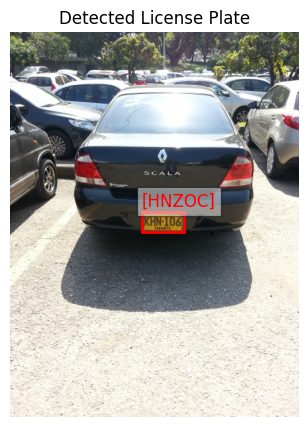

Processing image: foto12.jpg
Real plates: ['GXN394', 'MFW294', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto12.jpg: 640x480 2 plates, 12.1ms
Speed: 2.1ms preprocess, 12.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)


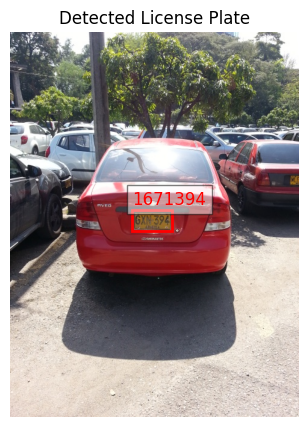

Processing image: fotoPlaca50.jpg
Real plates: ['CTK9G27', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca50.jpg: 640x640 1 plate, 12.3ms
Speed: 2.7ms preprocess, 12.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Processing image: foto5.jpg
Real plates: ['MNL864', 'MOL514', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto5.jpg: 480x640 2 plates, 18.5ms
Speed: 3.0ms preprocess, 18.5ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


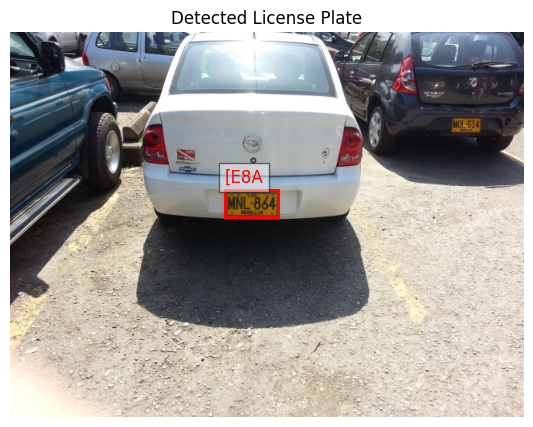

Processing image: fotoPlaca86.jpg
Real plates: ['GIS0747', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca86.jpg: 640x640 1 plate, 12.8ms
Speed: 3.3ms preprocess, 12.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


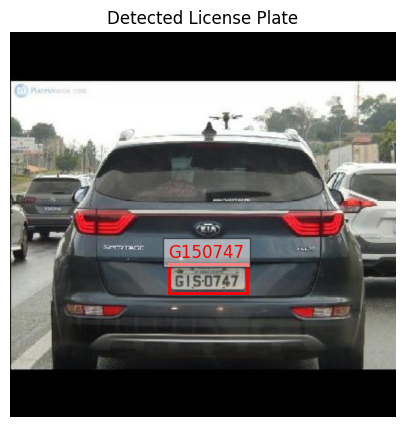

Processing image: fotoPlaca53.jpg
Real plates: ['BE19173', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca53.jpg: 640x640 1 plate, 13.6ms
Speed: 2.8ms preprocess, 13.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


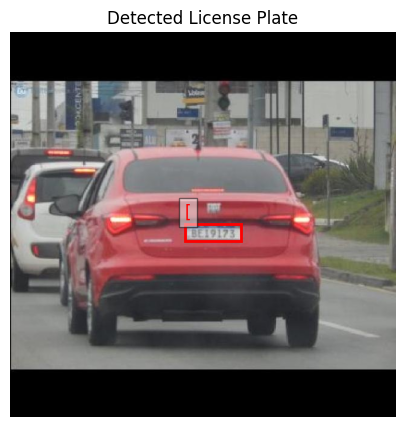

Processing image: foto23.jpg
Real plates: ['MOO866', 'TMX969', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto23.jpg: 480x640 1 plate, 13.9ms
Speed: 2.2ms preprocess, 13.9ms inference, 3.4ms postprocess per image at shape (1, 3, 480, 640)


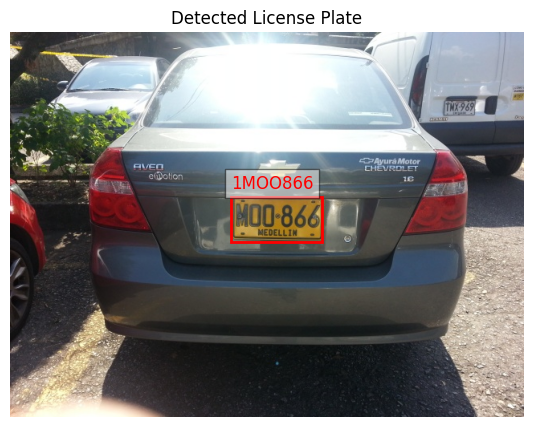

Processing image: fotoPlaca101.jpg
Real plates: ['DAX5E81', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca101.jpg: 640x640 1 plate, 12.7ms
Speed: 2.8ms preprocess, 12.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Processing image: foto8.jpg
Real plates: ['MNE643', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto8.jpg: 640x480 3 plates, 12.5ms
Speed: 2.1ms preprocess, 12.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)


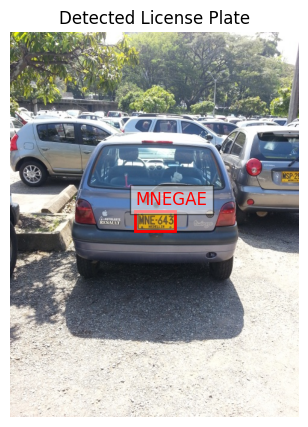

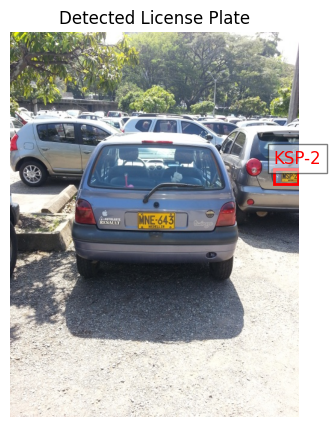

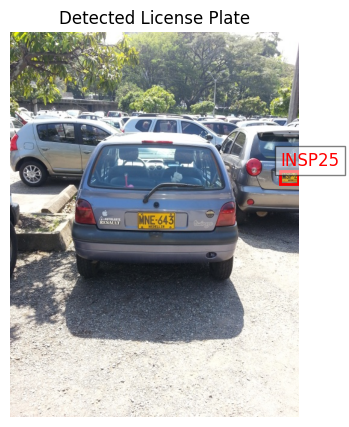

Processing image: foto30.jpg
Real plates: ['BXR307', 'MTV784', 'LAK236']

image 1/1 /content/datasets/placas_redimensionadas/foto30.jpg: 480x640 2 plates, 13.2ms
Speed: 2.3ms preprocess, 13.2ms inference, 2.4ms postprocess per image at shape (1, 3, 480, 640)


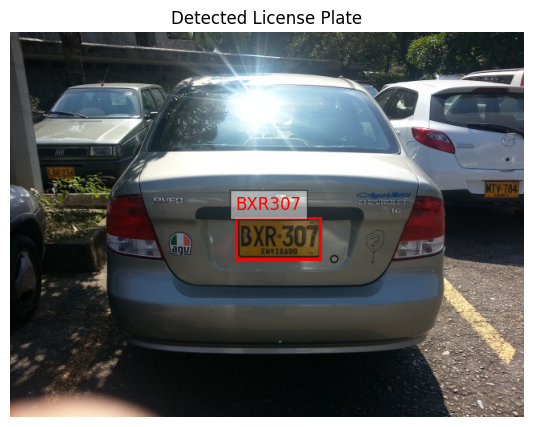

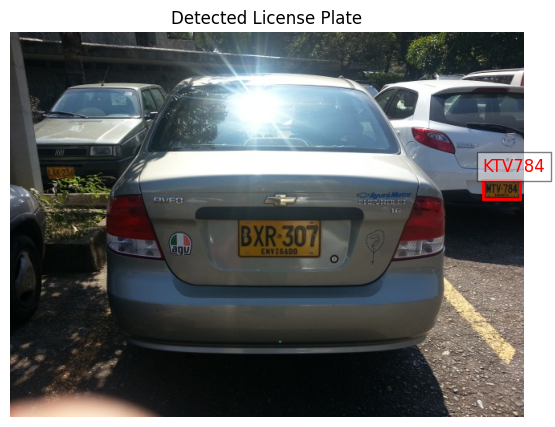

Processing image: fotoPlaca35.jpg
Real plates: ['LZB9466', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca35.jpg: 640x640 1 plate, 13.8ms
Speed: 2.9ms preprocess, 13.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


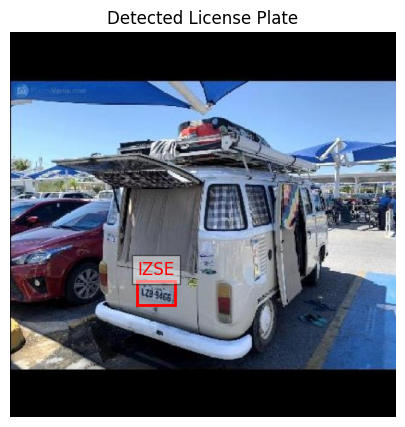

Processing image: fotoPlaca54.jpg
Real plates: ['AWA8563', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca54.jpg: 640x640 1 plate, 11.9ms
Speed: 2.8ms preprocess, 11.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Processing image: fotoPlaca79.jpg
Real plates: ['BCC2C09', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca79.jpg: 640x640 1 plate, 19.4ms
Speed: 5.3ms preprocess, 19.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


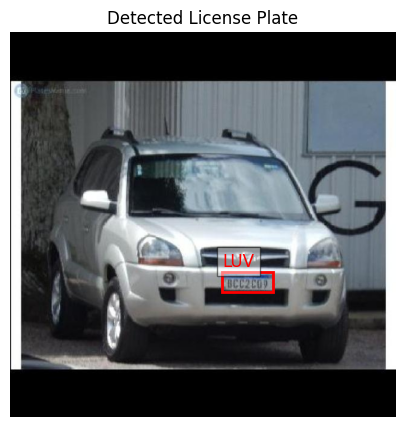

Processing image: fotoPlaca38.jpg
Real plates: ['DRF6436', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca38.jpg: 640x640 1 plate, 12.7ms
Speed: 3.0ms preprocess, 12.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


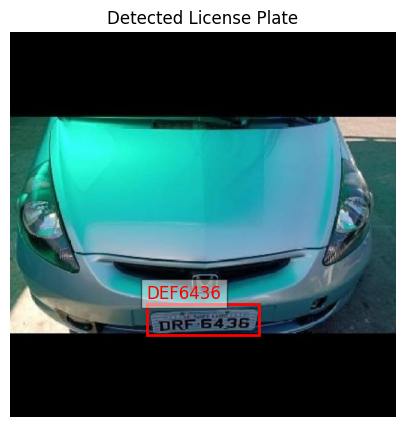

Processing image: fotoPlaca100.jpg
Real plates: ['ANM5362', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca100.jpg: 640x640 (no detections), 11.6ms
Speed: 2.8ms preprocess, 11.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Processing image: fotoPlaca36.jpg
Real plates: ['OJR1317', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca36.jpg: 640x640 2 plates, 13.0ms
Speed: 3.3ms preprocess, 13.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


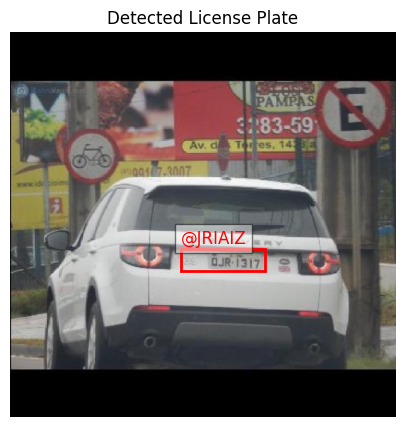

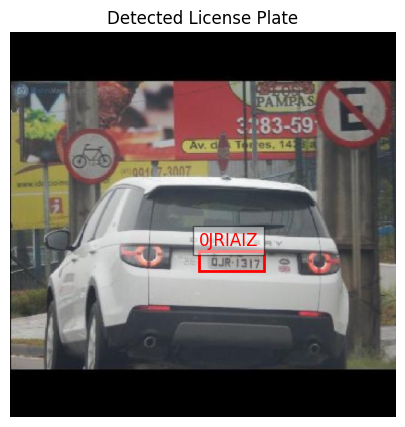

Processing image: foto25.jpg
Real plates: ['TMX969', 'HXW133', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto25.jpg: 480x640 2 plates, 17.0ms
Speed: 2.2ms preprocess, 17.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


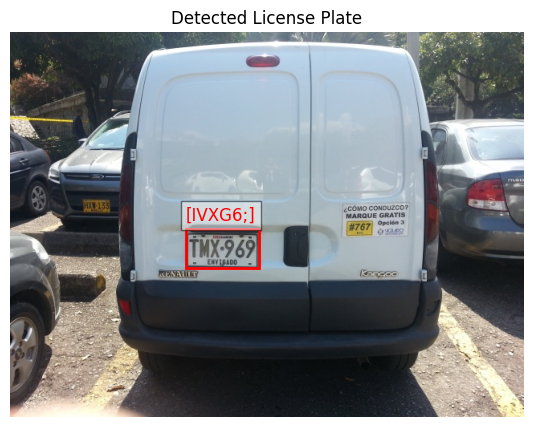

Processing image: fotoPlaca82.jpg
Real plates: ['QIQ8781', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca82.jpg: 640x640 2 plates, 17.4ms
Speed: 3.0ms preprocess, 17.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


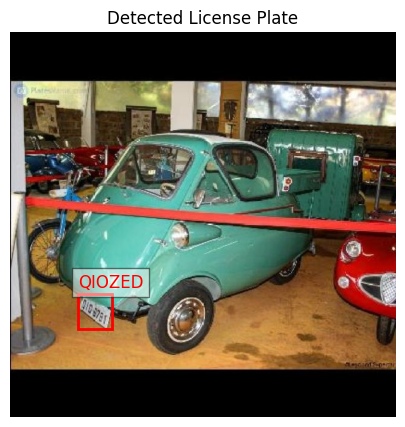

Processing image: fotoPlaca62.jpg
Real plates: ['PXA7615', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca62.jpg: 640x640 1 plate, 12.6ms
Speed: 2.9ms preprocess, 12.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


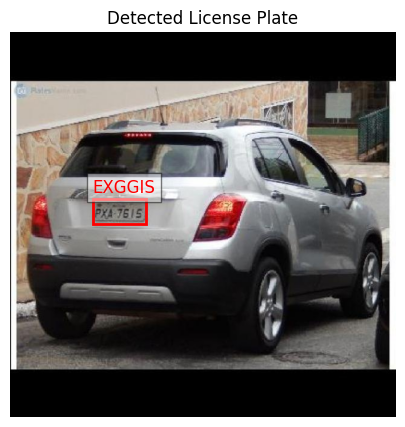

Processing image: fotoPlaca99.jpg
Real plates: ['BRD5750', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca99.jpg: 640x640 2 plates, 12.4ms
Speed: 2.7ms preprocess, 12.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Processing image: foto2.jpg
Real plates: ['FBS997', 'DLW295', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto2.jpg: 480x640 1 plate, 12.6ms
Speed: 4.3ms preprocess, 12.6ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


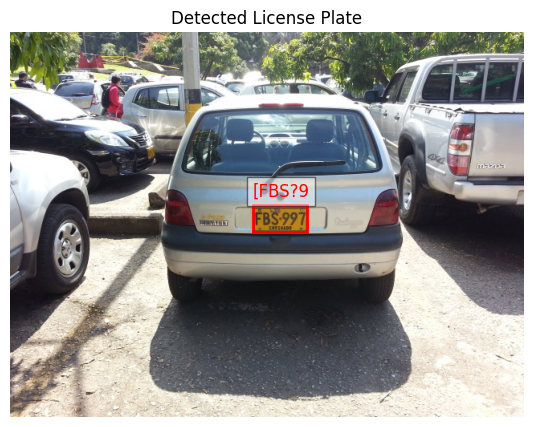

Processing image: foto11.jpg
Real plates: ['BZT613', 'NFG502', 'FAT904']

image 1/1 /content/datasets/placas_redimensionadas/foto11.jpg: 480x640 3 plates, 24.1ms
Speed: 2.3ms preprocess, 24.1ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


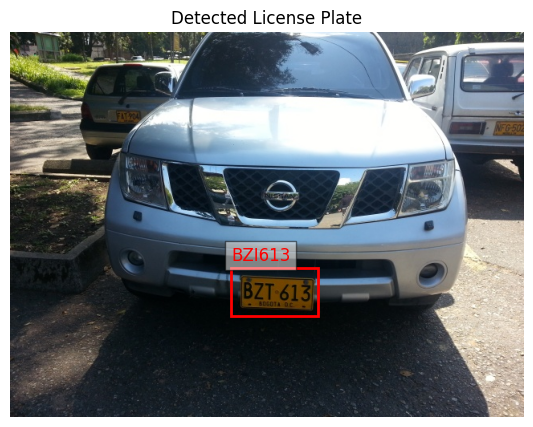

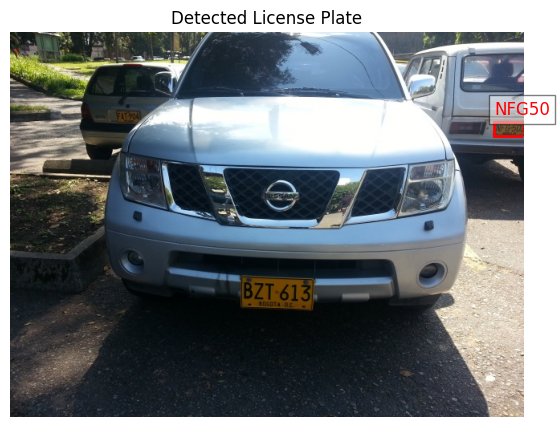

Processing image: fotoPlaca81.jpg
Real plates: ['FTR1H81', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca81.jpg: 640x640 1 plate, 12.1ms
Speed: 2.9ms preprocess, 12.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


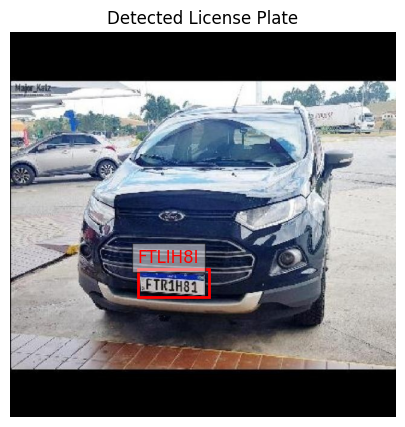

Processing image: fotoPlaca98.jpg
Real plates: ['JIQ7197', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca98.jpg: 640x640 2 plates, 12.6ms
Speed: 2.8ms preprocess, 12.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


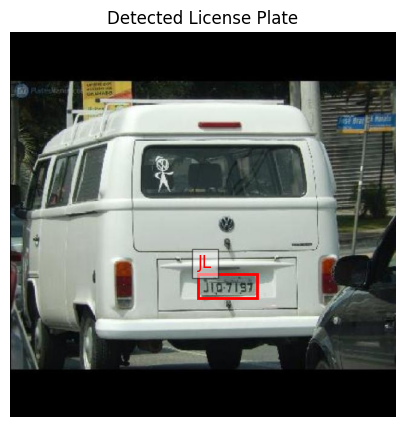

Processing image: fotoPlaca30.jpg
Real plates: ['PKL7730', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca30.jpg: 640x640 1 plate, 12.0ms
Speed: 2.7ms preprocess, 12.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


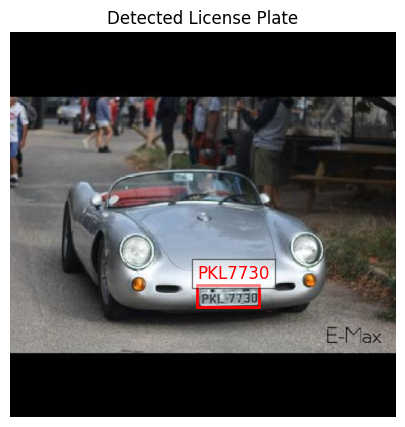

Processing image: fotoPlaca84.jpg
Real plates: ['RFB4D54', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca84.jpg: 640x640 1 plate, 11.6ms
Speed: 2.8ms preprocess, 11.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


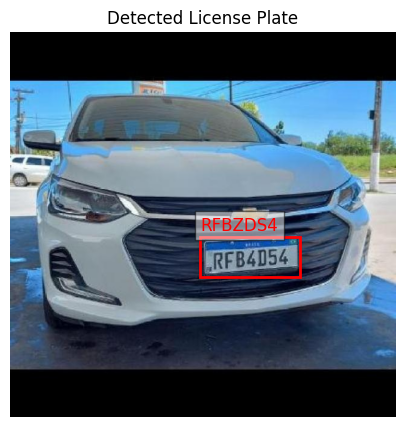

Processing image: fotoPlaca46.jpg
Real plates: ['CCT5862', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca46.jpg: 640x640 1 plate, 11.7ms
Speed: 2.8ms preprocess, 11.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


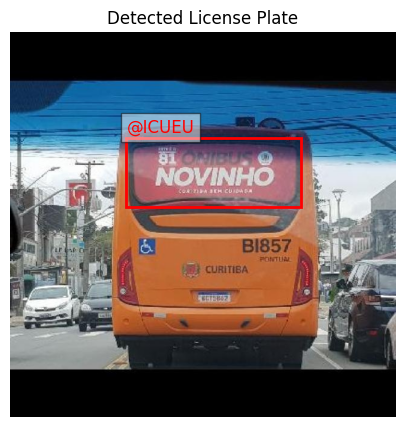

Processing image: fotoPlaca72.jpg
Real plates: ['EZD9283', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca72.jpg: 640x640 1 plate, 14.5ms
Speed: 2.9ms preprocess, 14.5ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


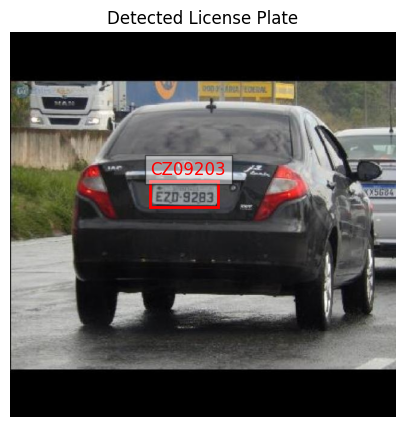

Processing image: fotoPlaca31.jpg
Real plates: ['AXX6704', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca31.jpg: 640x640 1 plate, 12.1ms
Speed: 2.8ms preprocess, 12.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


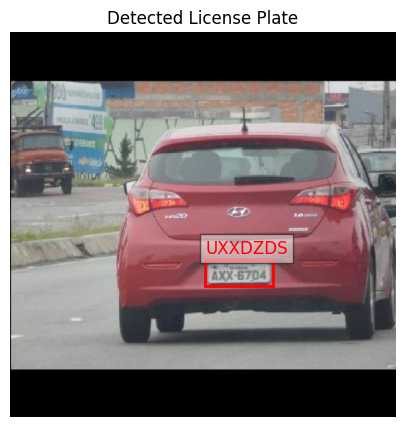

Processing image: fotoPlaca88.jpg
Real plates: ['AUB5038', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca88.jpg: 640x640 3 plates, 12.1ms
Speed: 2.8ms preprocess, 12.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Processing image: fotoPlaca97.jpg
Real plates: ['AKI5J19', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca97.jpg: 640x640 1 plate, 19.4ms
Speed: 2.7ms preprocess, 19.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


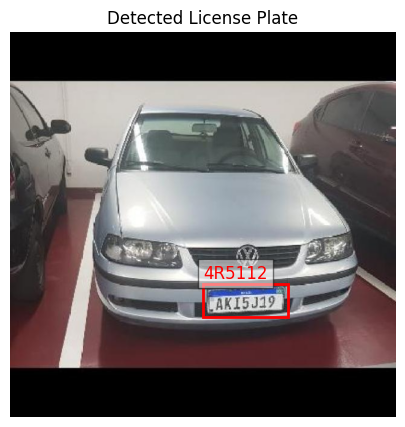

Processing image: foto10.jpg
Real plates: ['HXY367', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto10.jpg: 640x480 1 plate, 13.2ms
Speed: 2.4ms preprocess, 13.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)


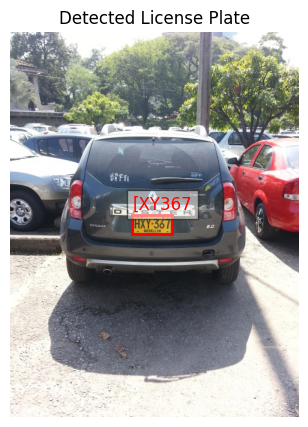

Processing image: fotoPlaca95.jpg
Real plates: ['JPB6898', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca95.jpg: 640x640 1 plate, 17.9ms
Speed: 2.7ms preprocess, 17.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


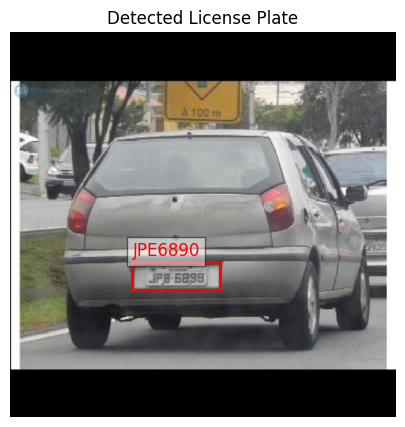

Processing image: foto24.jpg
Real plates: ['KAI816', 'DRF004', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto24.jpg: 640x480 1 plate, 12.9ms
Speed: 2.2ms preprocess, 12.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)


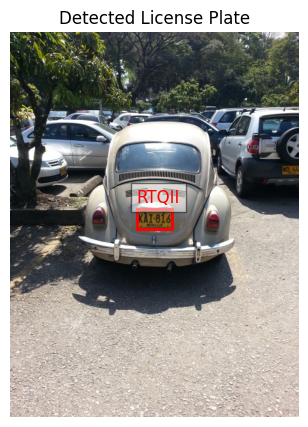

Processing image: foto4.jpg
Real plates: ['LAL700', 'MNL864', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto4.jpg: 480x640 2 plates, 13.4ms
Speed: 2.2ms preprocess, 13.4ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


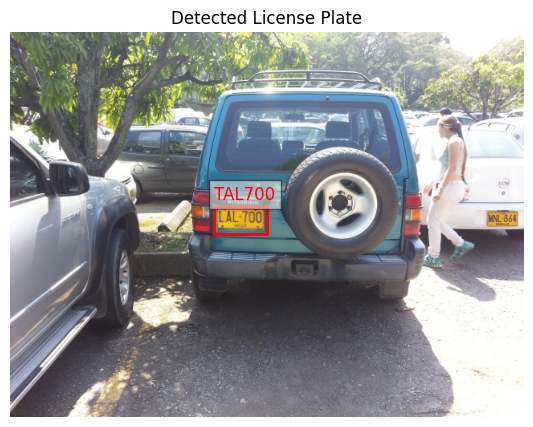

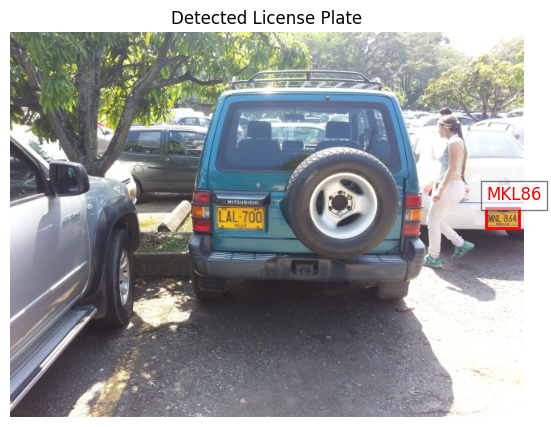

Processing image: fotoPlaca64.jpg
Real plates: ['ANR7427', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca64.jpg: 640x640 1 plate, 12.9ms
Speed: 4.7ms preprocess, 12.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


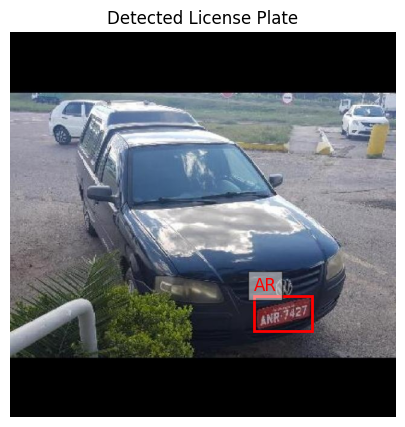

Processing image: fotoPlaca75.jpg
Real plates: ['GWH7815', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca75.jpg: 640x640 1 plate, 11.8ms
Speed: 2.8ms preprocess, 11.8ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


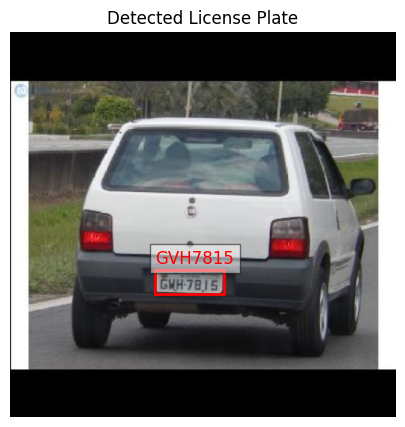

Processing image: fotoPlaca93.jpg
Real plates: ['BBL0474', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca93.jpg: 640x640 1 plate, 12.6ms
Speed: 7.0ms preprocess, 12.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


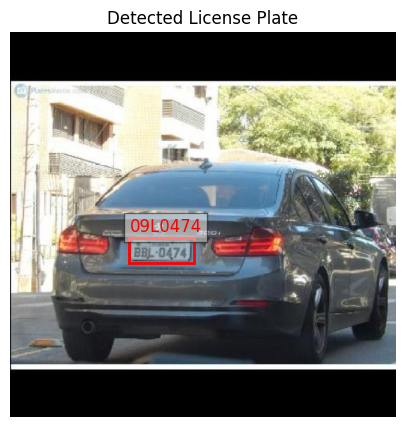

Processing image: fotoPlaca57.jpg
Real plates: ['HHY9721', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca57.jpg: 640x640 1 plate, 19.4ms
Speed: 2.8ms preprocess, 19.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


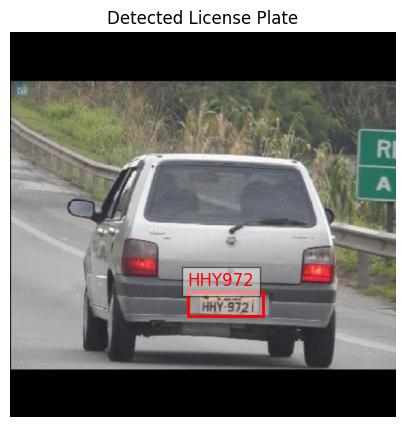

Processing image: fotoPlaca80.jpg
Real plates: ['RFQ2H69', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca80.jpg: 640x640 1 plate, 12.4ms
Speed: 2.8ms preprocess, 12.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


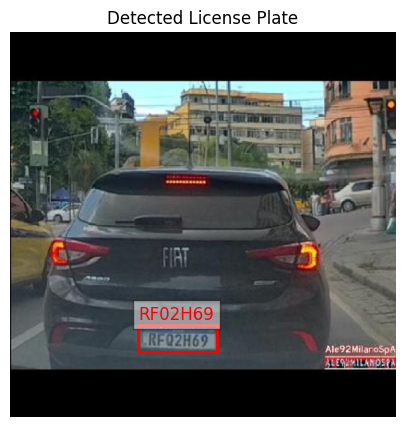

Processing image: fotoPlaca61.jpg
Real plates: ['JEQ2201', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca61.jpg: 640x640 1 plate, 13.0ms
Speed: 3.0ms preprocess, 13.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


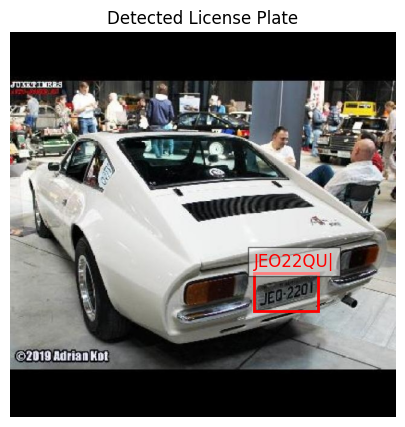

Processing image: foto18.jpg
Real plates: ['KMT806', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto18.jpg: 480x640 1 plate, 18.2ms
Speed: 2.9ms preprocess, 18.2ms inference, 2.6ms postprocess per image at shape (1, 3, 480, 640)


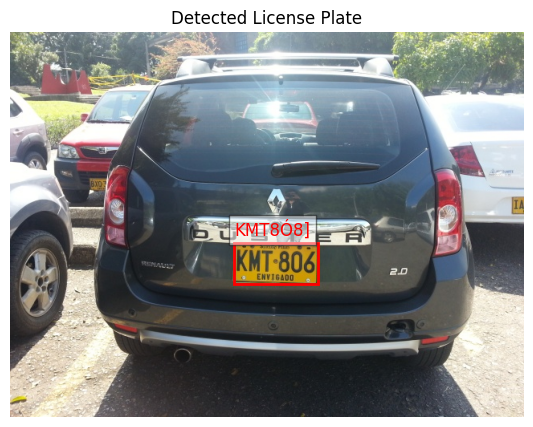

Processing image: fotoPlaca39.jpg
Real plates: ['BBT5192', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca39.jpg: 640x640 2 plates, 13.5ms
Speed: 2.8ms preprocess, 13.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


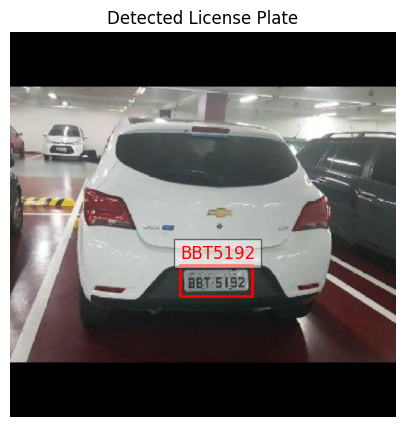

Processing image: fotoPlaca70.jpg
Real plates: ['PGP5173', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca70.jpg: 640x640 1 plate, 11.7ms
Speed: 2.8ms preprocess, 11.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


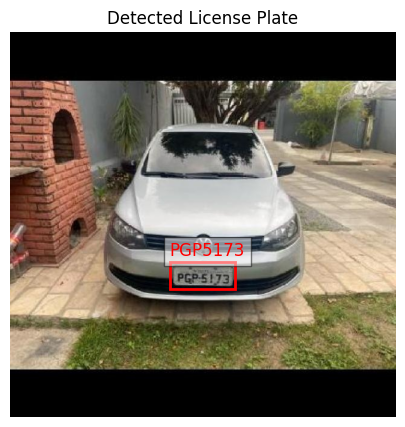

Processing image: fotoPlaca44.jpg
Real plates: ['CGE8186', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca44.jpg: 640x640 1 plate, 11.7ms
Speed: 2.7ms preprocess, 11.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


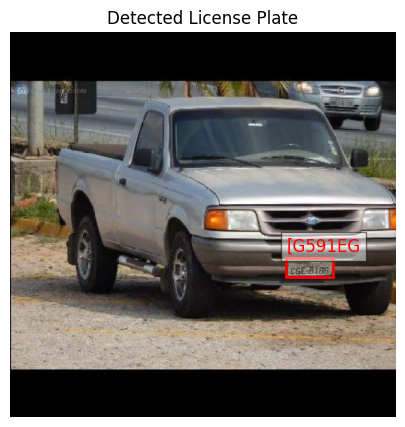

Processing image: foto27.jpg
Real plates: ['MOL666', 'KBP516', 'DFW285']

image 1/1 /content/datasets/placas_redimensionadas/foto27.jpg: 640x480 2 plates, 16.3ms
Speed: 2.4ms preprocess, 16.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 480)


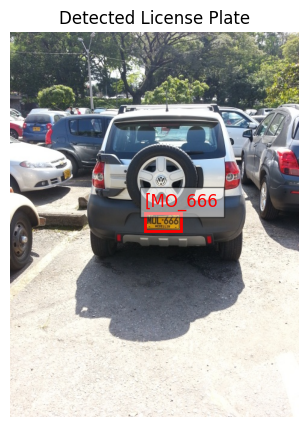

Processing image: foto29.jpg
Real plates: ['MVV827', 'MNT754', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto29.jpg: 640x480 1 plate, 13.9ms
Speed: 2.2ms preprocess, 13.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)


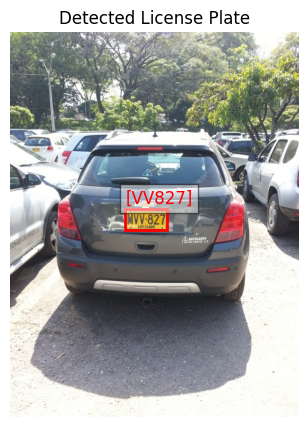

Processing image: fotoPlaca56.jpg
Real plates: ['NLO2I92', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca56.jpg: 640x640 1 plate, 19.3ms
Speed: 2.9ms preprocess, 19.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


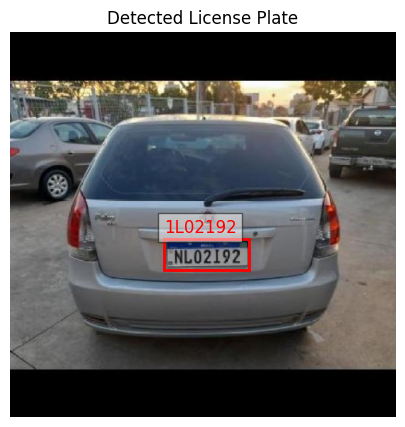

Processing image: fotoPlaca33.jpg
Real plates: ['GGF6290', 'FEK6156', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca33.jpg: 640x640 2 plates, 12.0ms
Speed: 2.7ms preprocess, 12.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


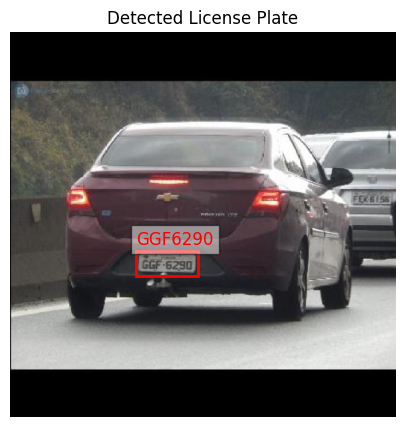

Processing image: fotoPlaca60.jpg
Real plates: ['FRU2967', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca60.jpg: 640x640 1 plate, 17.0ms
Speed: 3.3ms preprocess, 17.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


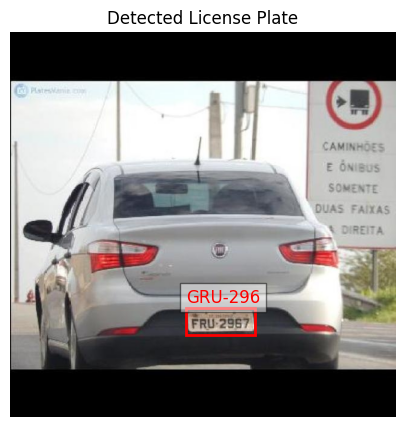

Processing image: foto3.jpg
Real plates: ['FHA404', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto3.jpg: 480x640 1 plate, 12.4ms
Speed: 2.2ms preprocess, 12.4ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


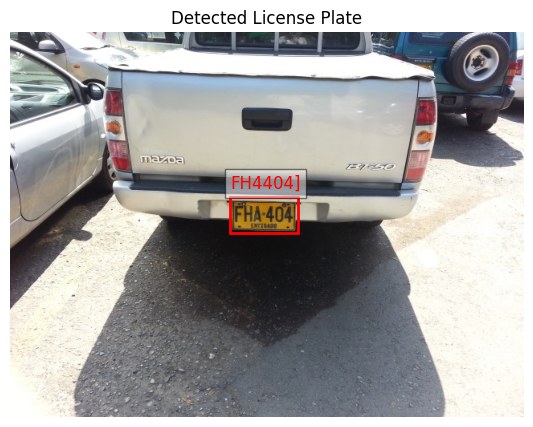

Processing image: foto22.jpg
Real plates: ['KBQ643', 'FHN374', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto22.jpg: 640x480 1 plate, 13.5ms
Speed: 2.2ms preprocess, 13.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)


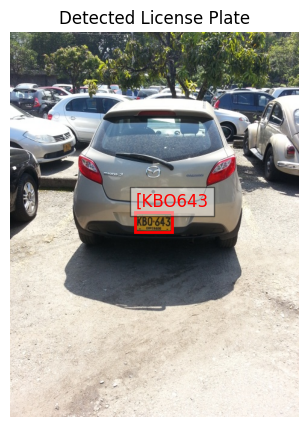

Processing image: foto9.jpg
Real plates: ['MSP253', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto9.jpg: 640x480 1 plate, 13.9ms
Speed: 2.2ms preprocess, 13.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 480)


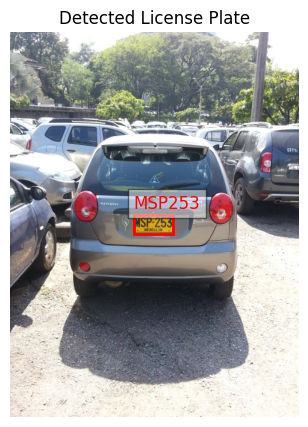

Processing image: fotoPlaca51.jpg
Real plates: ['PKL7730', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca51.jpg: 640x640 1 plate, 17.4ms
Speed: 2.9ms preprocess, 17.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)
Processing image: fotoPlaca42.jpg
Real plates: ['EVV8753', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca42.jpg: 640x640 1 plate, 12.9ms
Speed: 2.7ms preprocess, 12.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


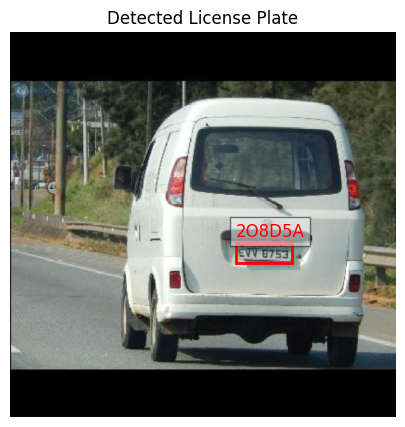

Processing image: fotoPlaca83.jpg
Real plates: ['PMH3550', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca83.jpg: 640x640 2 plates, 11.9ms
Speed: 2.7ms preprocess, 11.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Processing image: foto26.jpg
Real plates: ['FGV915', 'MVW162', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto26.jpg: 480x640 1 plate, 19.3ms
Speed: 2.3ms preprocess, 19.3ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


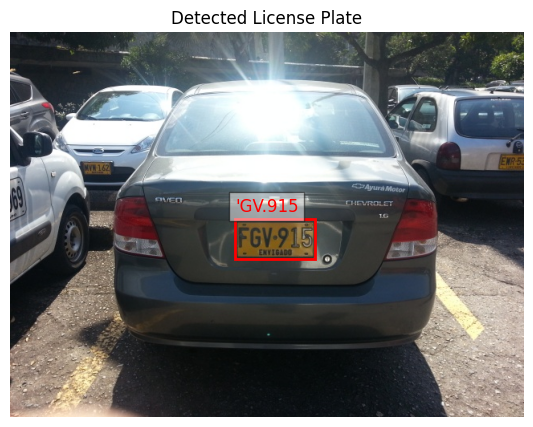

Processing image: foto16.jpg
Real plates: ['FGH847', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto16.jpg: 480x640 4 plates, 14.4ms
Speed: 2.1ms preprocess, 14.4ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 640)


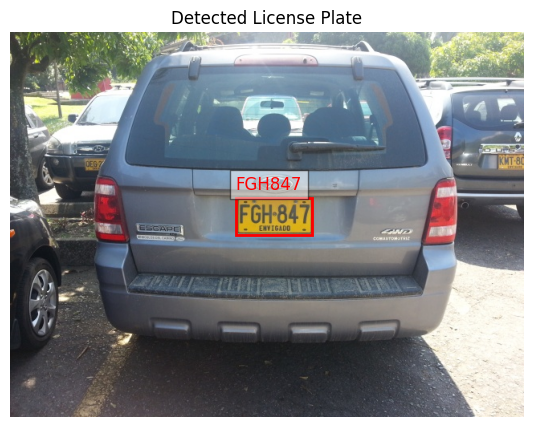

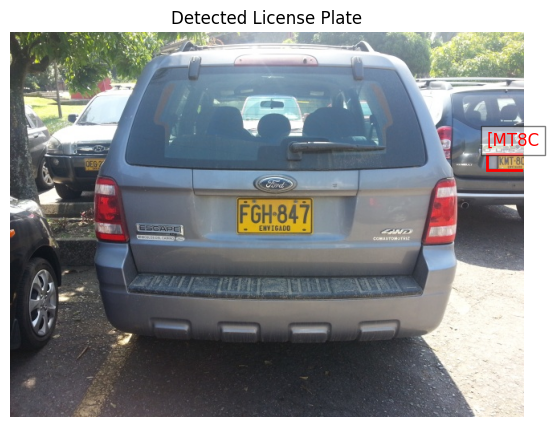

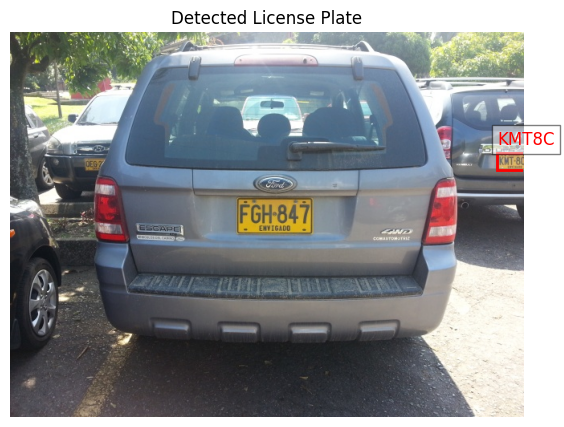

Processing image: fotoPlaca71.jpg
Real plates: ['RFB8A59', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca71.jpg: 640x640 1 plate, 12.9ms
Speed: 2.9ms preprocess, 12.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


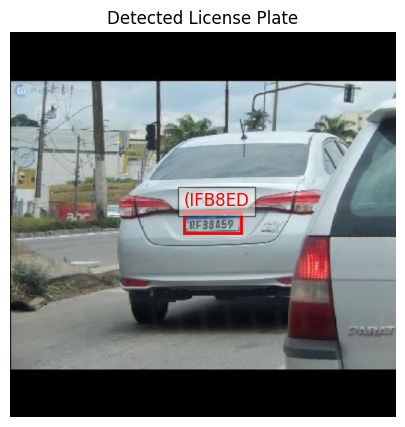

Processing image: fotoPlaca78.jpg
Real plates: ['HVH5C36', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca78.jpg: 640x640 1 plate, 12.2ms
Speed: 3.0ms preprocess, 12.2ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


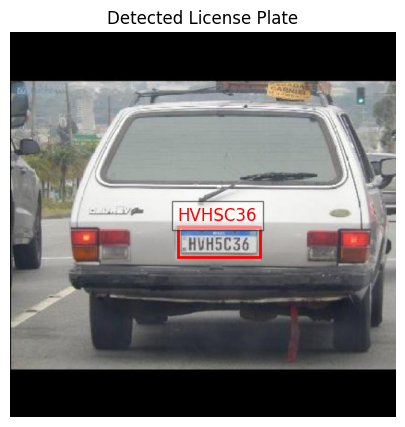

Processing image: fotoPlaca76.jpg
Real plates: ['AUL1G66', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca76.jpg: 640x640 1 plate, 14.7ms
Speed: 2.9ms preprocess, 14.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


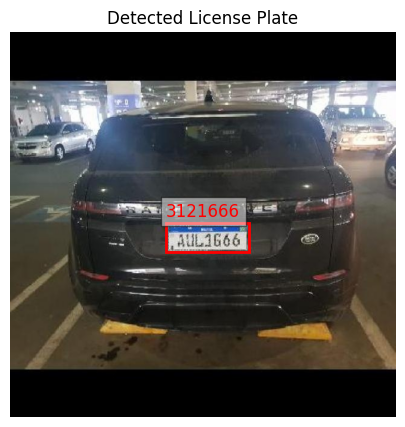

Processing image: foto17.jpg
Real plates: ['MMW015', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto17.jpg: 640x480 1 plate, 17.5ms
Speed: 2.3ms preprocess, 17.5ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 480)


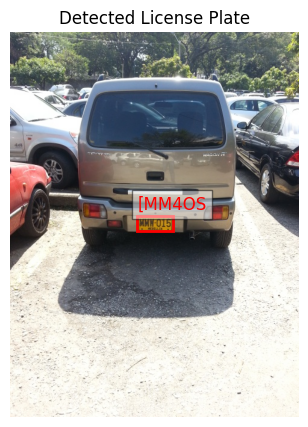

Processing image: fotoPlaca69.jpg
Real plates: ['IBFGA30', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca69.jpg: 640x640 1 plate, 13.5ms
Speed: 2.8ms preprocess, 13.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


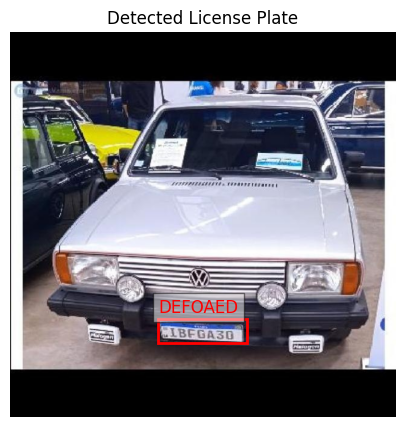

Processing image: foto6.jpg
Real plates: ['MOL514', 'EKO157', 'DHO284']

image 1/1 /content/datasets/placas_redimensionadas/foto6.jpg: 480x640 2 plates, 14.1ms
Speed: 2.2ms preprocess, 14.1ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


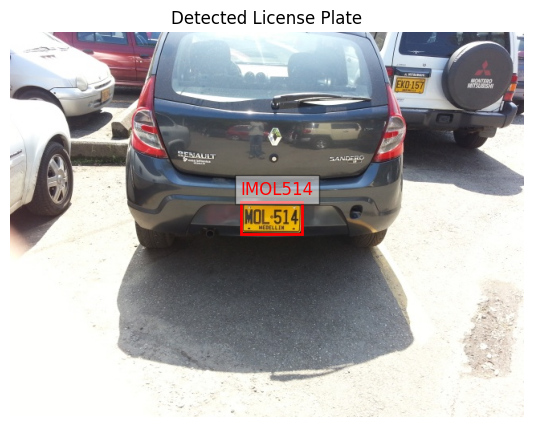

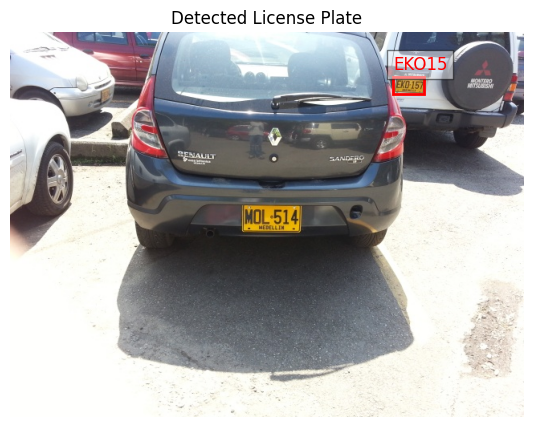

Processing image: fotoPlaca52.jpg
Real plates: ['BVZ5G00', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca52.jpg: 640x640 1 plate, 26.3ms
Speed: 2.9ms preprocess, 26.3ms inference, 7.7ms postprocess per image at shape (1, 3, 640, 640)


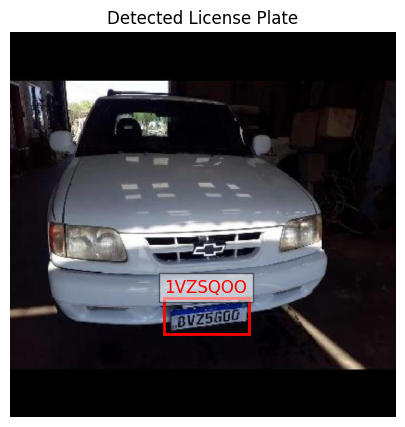

Processing image: foto7.jpg
Real plates: ['EKO157', 'IAQ016', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto7.jpg: 640x480 1 plate, 17.3ms
Speed: 2.3ms preprocess, 17.3ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 480)


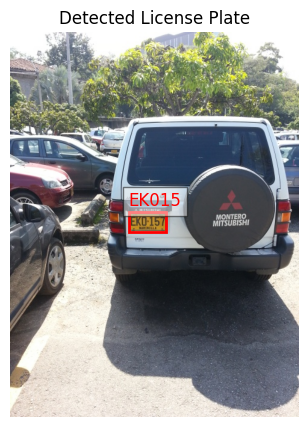

Processing image: foto1.jpg
Real plates: ['MIV792', 'FBS997', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto1.jpg: 480x640 3 plates, 24.5ms
Speed: 2.3ms preprocess, 24.5ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


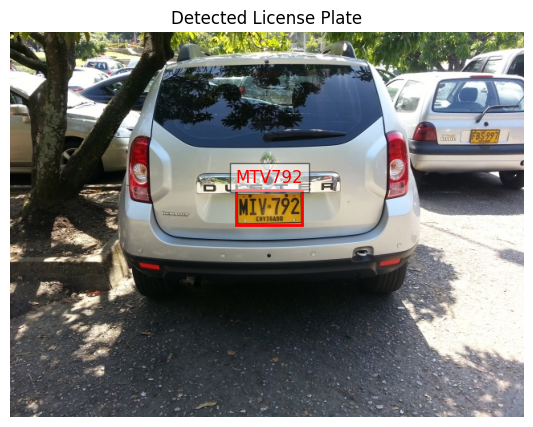

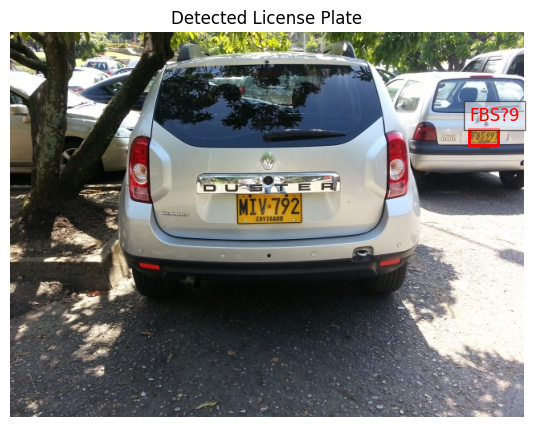

Processing image: foto28.jpg
Real plates: ['EWR536', 'IAO515', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto28.jpg: 480x640 3 plates, 11.7ms
Speed: 2.4ms preprocess, 11.7ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


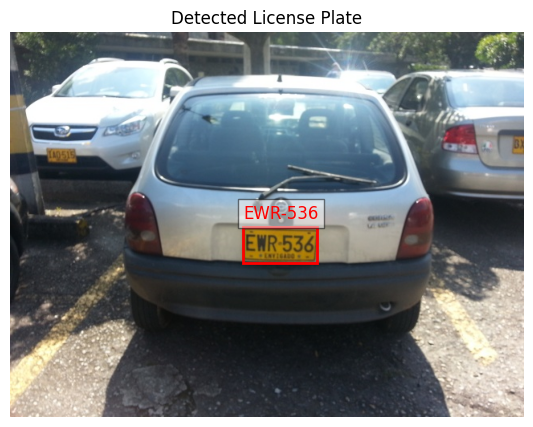

Processing image: fotoPlaca96.jpg
Real plates: ['BEB7D24', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca96.jpg: 640x640 1 plate, 12.2ms
Speed: 2.7ms preprocess, 12.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


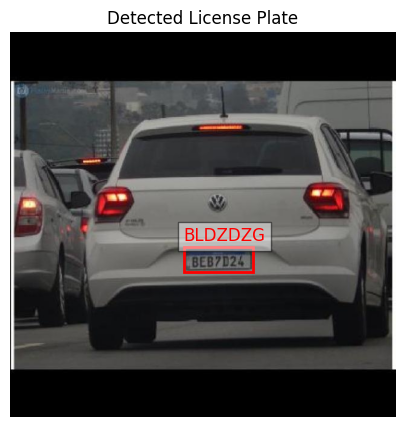

Processing image: fotoPlaca66.jpg
Real plates: ['PZV2190', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca66.jpg: 640x640 1 plate, 15.6ms
Speed: 2.9ms preprocess, 15.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


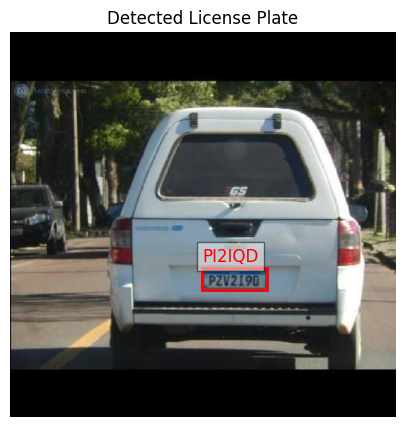

Processing image: fotoPlaca68.jpg
Real plates: ['EPK1H65', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca68.jpg: 640x640 1 plate, 12.3ms
Speed: 2.8ms preprocess, 12.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


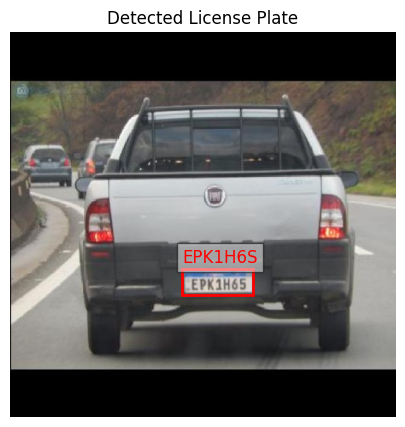

Processing image: fotoPlaca63.jpg
Real plates: ['A2C9A53', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca63.jpg: 640x640 1 plate, 11.8ms
Speed: 2.8ms preprocess, 11.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


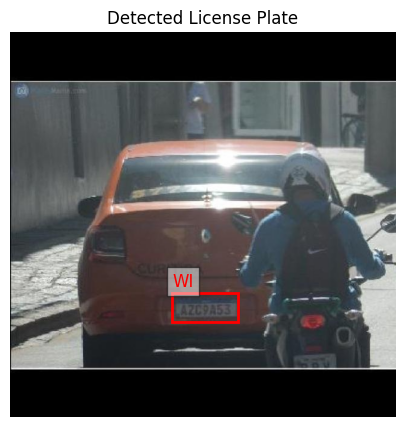

Processing image: fotoPlaca41.jpg
Real plates: ['PWT4264', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca41.jpg: 640x640 1 plate, 18.6ms
Speed: 2.9ms preprocess, 18.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


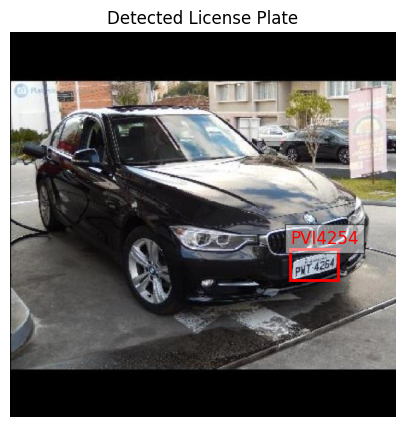

Processing image: foto14.jpg
Real plates: ['MVV245', 'DHZ174', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/foto14.jpg: 480x640 3 plates, 25.2ms
Speed: 2.4ms preprocess, 25.2ms inference, 2.8ms postprocess per image at shape (1, 3, 480, 640)


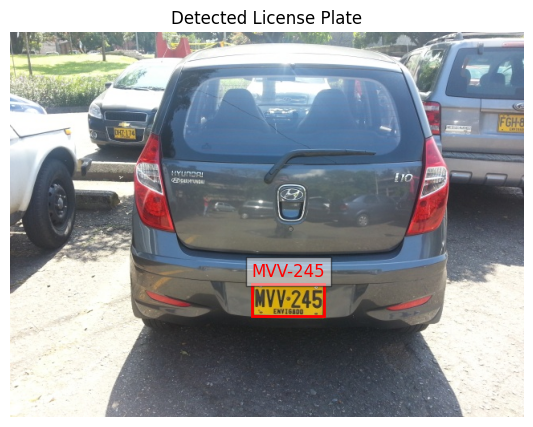

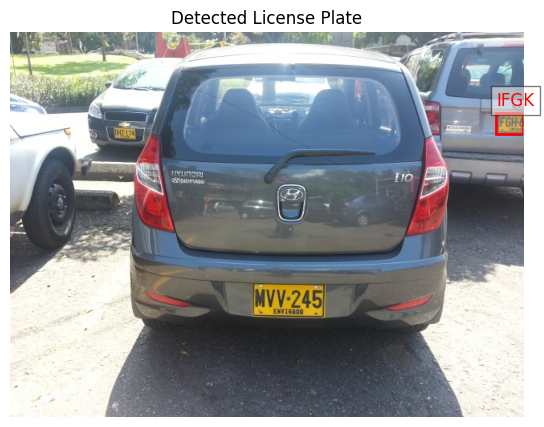

Processing image: fotoPlaca91.jpg
Real plates: ['RBE7F11', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca91.jpg: 640x640 1 plate, 14.3ms
Speed: 3.0ms preprocess, 14.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Processing image: fotoPlaca34.jpg
Real plates: ['KEX8238', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca34.jpg: 640x640 1 plate, 12.4ms
Speed: 2.6ms preprocess, 12.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


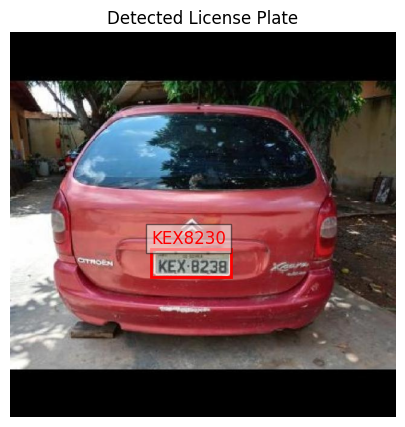

Processing image: fotoPlaca48.jpg
Real plates: ['BDE6J06', 'NAN', 'NAN']

image 1/1 /content/datasets/placas_redimensionadas/fotoPlaca48.jpg: 640x640 1 plate, 12.0ms
Speed: 2.8ms preprocess, 12.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


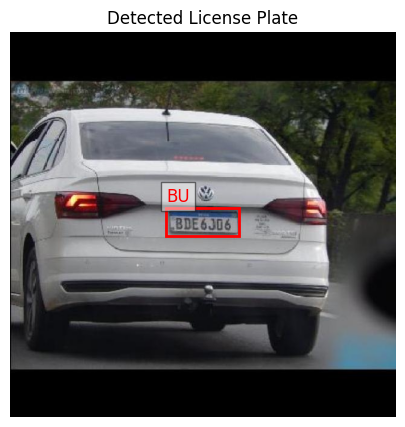

Porcentaje de efectividad del modelo: 9.00%


In [ ]:
# Evaluación del modelo
folder_path = '/content/datasets/placas_redimensionadas'
image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

correct_detections = 0

# Procesar cada imagen
for img_file in image_files:
    img_path = os.path.join(folder_path, img_file)

    # Obtener las placas reales de las 3 columnas y normalizarlas
    real_plates = (
        df_placas[df_placas['imagen'] == img_file][['placa1', 'placa2', 'placa3']]
        .apply(lambda col: col.astype(str).map(normalize_text))  # Normalizar cada placa
        .values.flatten()  # Convertir a una lista plana
        .tolist()
    )

    print(f"Processing image: {img_file}")
    print(f"Real plates: {real_plates}")

    # Verificar si la detección es correcta
    if detect_license_plates(img_path, real_plates):
        correct_detections += 1

# Calcular efectividad
total_images = len(image_files)
effectiveness = (correct_detections / total_images) * 100 if total_images > 0 else 0
print(f"Porcentaje de efectividad del modelo: {effectiveness:.2f}%")